## Mouad RIALI

Task objectives :
- Perform ‘Exploratory Data Analysis’ on dataset ‘Global Terrorism’
- find out the hot zone of terrorism.
- What all security issues and insights you can derive by EDA?

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas_profiling as pp
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go


%matplotlib inline

In [2]:
df=pd.read_csv("globalterrorismdb_0718dist.csv")
df.head()

/home/mouad/.virtualenvs/ml/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3155: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [3]:
#df.columns.values

In [4]:
df.info()
set(df.crit3.dropna().values)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


{0, 1}

In [5]:
df.dropna(axis=1).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 29 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   eventid          181691 non-null  int64 
 1   iyear            181691 non-null  int64 
 2   imonth           181691 non-null  int64 
 3   iday             181691 non-null  int64 
 4   extended         181691 non-null  int64 
 5   country          181691 non-null  int64 
 6   country_txt      181691 non-null  object
 7   region           181691 non-null  int64 
 8   region_txt       181691 non-null  object
 9   vicinity         181691 non-null  int64 
 10  crit1            181691 non-null  int64 
 11  crit2            181691 non-null  int64 
 12  crit3            181691 non-null  int64 
 13  success          181691 non-null  int64 
 14  suicide          181691 non-null  int64 
 15  attacktype1      181691 non-null  int64 
 16  attacktype1_txt  181691 non-null  object
 17  targtype1 

### Find the hot zone of terrorism: 

In [6]:
dfCountry = df.groupby(['country_txt']).count().sort_values(by=['eventid'])
dfCountrySum = df.groupby(['country_txt']).sum(['nkill','nwound','proprety']).sort_values(by=['eventid'])
#fig = px.line(dfCountry, y='eventid', x=dfCountry.index.values) #text=dfCountry.index.values)
#fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
#fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig = go.Figure()
fig.add_trace(go.Scatter(y=dfCountry['eventid'].values, x=dfCountry.index.values,name='Attacks'))
fig.add_trace(go.Scatter(y=dfCountrySum['nkill'].values, x=dfCountry.index.values,name='Kills'))
fig.add_trace(go.Scatter(y=dfCountrySum['nwound'].values, x=dfCountry.index.values,name='Wounds'))
#fig.add_trace(go.Scatter(y=dfCountrySum['proprety'].values, x=dfCountry.index.values,name='Proprety'))

fig.update_layout(hovermode='x unified',title="Attacks, Kills, Wounds by country between : 1970 & 2017")
fig.show()

In [7]:
mean = dfCountry.eventid.values.mean()
std = np.std(dfCountry.eventid.values)
dfCountry["Stat_Model"]= (dfCountry.eventid.values-mean)/std

fig = px.bar(dfCountry, y='Stat_Model', x=dfCountry.index.values, text=dfCountry.index.values)
#fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

In [8]:
dfMap=df.where(df['latitude']!=None).sort_values(by='iyear')

dfMap=dfMap.groupby(['iyear','latitude','longitude','city','country_txt']).count()
a=dfMap.index.values
l=list(a)
Alt = [x[1] for x in l]
Long = [y[2] for y in l]
Years= [a[0] for a in l]
Countries= [c[-1] for c in l]
Cities = [c[-2] for c in l]
#print(Cities)
Alt = np.array(Alt)
Long = np.array(Long)
Years = np.array(Years)
Countries = np.array(Countries)
Cities=np.array(Cities)

In [38]:
fig = px.scatter_geo(dfMap, lon=Long,lat=Alt ,#color=Countries,
                     hover_name=Cities, 
                     animation_frame=Years,
                     projection="equirectangular",
                    labels={"eventid": "Attacks",'animation_frame':'Year'})
fig.update_layout(title='Map of terrorism attacks in the world between : 1970 & 2017 - Scatter')
fig.show()

In [10]:
fig = px.density_mapbox(dfMap, lon=Long,lat=Alt, z='eventid', radius=10,
                        #center=dict(lat=0, lon=180), 
                        hover_name=Countries,
                        animation_frame=Years,zoom=1,
                        mapbox_style="open-street-map",
                       labels={"eventid": "Attacks",'animation_frame':'Year'})
fig.update_layout(title='Map of terrorism attacks in the world between : 1970 & 2017 - Heat Map')

fig.show()

In [11]:
dfYears = df.groupby(['iyear']).count().sort_values(by="iyear")
mean = dfYears.eventid.values.mean()
std = np.std(dfYears.eventid.values)
dfYears["Stat_Model"]= (dfYears.eventid.values-mean)/std


fig = px.bar(dfYears, y='Stat_Model', x=dfYears.index.values, 
             text=dfYears.index.values,
            labels={"x": "Years",'Stat_Model':'Attacks rate'})
#fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide',title='Global attacks rate By Years')
fig.show()

In [12]:
class1 = np.array(range(1970,1989))
class2 = np.array(range(1989,1993))
class3 = np.array(range(1993,2008))
class4 = np.array(range(2008,2018))

#df.loc[df.iyear.isin(np.array([1999]))]

def dfClass(n):
    if n == 1: return df.loc[df.iyear.isin(class1)]
    elif n == 2: return df.loc[df.iyear.isin(class2)]
    elif n == 3: return df.loc[df.iyear.isin(class4)]
    elif n == 4: return df.loc[df.iyear.isin(class4)]

#dfClass1.columns.values

In [13]:
dfWeap = df[["eventid","country_txt",'iyear', 'imonth', 'iday','weaptype1_txt','weaptype2_txt','weaptype3_txt','weaptype4_txt','attacktype1_txt']]

dfWeap

,eventid,country_txt,iyear,imonth,iday,weaptype1_txt,weaptype2_txt,weaptype3_txt,weaptype4_txt,attacktype1_txt
0,197000000001,Dominican Republic,1970,7,2,Unknown,NaN,NaN,NaN,Assassination
1,197000000002,Mexico,1970,0,0,Unknown,NaN,NaN,NaN,Hostage Taking (Kidnapping)
2,197001000001,Philippines,1970,1,0,Unknown,NaN,NaN,NaN,Assassination
3,197001000002,Greece,1970,1,0,Explosives,NaN,NaN,NaN,Bombing/Explosion
4,197001000003,Japan,1970,1,0,Incendiary,NaN,NaN,NaN,Facility/Infrastructure Attack
...,...,...,...,...,...,...,...,...,...,...
181686,201712310022,Somalia,2017,12,31,Firearms,NaN,NaN,NaN,Armed Assault
181687,201712310029,Syria,2017,12,31,Explosives,NaN,NaN,NaN,Bombing/Explosion
181688,201712310030,Philippines,2017,12,31,Incendiary,NaN,NaN,NaN,Facility/Infrastructure Attack
181689,201712310031,India,2017,12,31,Explosives,NaN,NaN,NaN,Bombing/Explosion


In [14]:
dfWeap.describe()

,eventid,iyear,imonth,iday
count,1.816910e+05,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644
std,1.325957e+09,13.259430,3.388303,8.814045
min,1.970000e+11,1970.000000,0.000000,0.000000
25%,1.991021e+11,1991.000000,4.000000,8.000000
50%,2.009022e+11,2009.000000,6.000000,15.000000
75%,2.014081e+11,2014.000000,9.000000,23.000000
max,2.017123e+11,2017.000000,12.000000,31.000000


In [15]:
Weap1=list(dfWeap.weaptype1_txt.values)
Weap2=list(dfWeap.weaptype2_txt.values)
Weap3=list(dfWeap.weaptype3_txt.values)
L = [str(Weap1[i])+","+str(Weap2[i])+","+str(Weap3[i]) for i in range(len(Weap1))]
#L

Weap = np.array(L)
dfWeap["Weapens"]=Weap
dfWeap

,eventid,country_txt,iyear,imonth,iday,weaptype1_txt,weaptype2_txt,weaptype3_txt,weaptype4_txt,attacktype1_txt,Weapens
0,197000000001,Dominican Republic,1970,7,2,Unknown,NaN,NaN,NaN,Assassination,"Unknown,nan,nan"
1,197000000002,Mexico,1970,0,0,Unknown,NaN,NaN,NaN,Hostage Taking (Kidnapping),"Unknown,nan,nan"
2,197001000001,Philippines,1970,1,0,Unknown,NaN,NaN,NaN,Assassination,"Unknown,nan,nan"
3,197001000002,Greece,1970,1,0,Explosives,NaN,NaN,NaN,Bombing/Explosion,"Explosives,nan,nan"
4,197001000003,Japan,1970,1,0,Incendiary,NaN,NaN,NaN,Facility/Infrastructure Attack,"Incendiary,nan,nan"
...,...,...,...,...,...,...,...,...,...,...,...
181686,201712310022,Somalia,2017,12,31,Firearms,NaN,NaN,NaN,Armed Assault,"Firearms,nan,nan"
181687,201712310029,Syria,2017,12,31,Explosives,NaN,NaN,NaN,Bombing/Explosion,"Explosives,nan,nan"
181688,201712310030,Philippines,2017,12,31,Incendiary,NaN,NaN,NaN,Facility/Infrastructure Attack,"Incendiary,nan,nan"
181689,201712310031,India,2017,12,31,Explosives,NaN,NaN,NaN,Bombing/Explosion,"Explosives,nan,nan"


In [16]:
fig = px.sunburst(dfWeap, path=['attacktype1_txt','weaptype1_txt','country_txt'],
                 labels={"count": "Attacks",'id':'path'},
                 title='Attack Type - Weapens type - Country')
fig.show()

In [17]:
#dfClass1
dfClass1 = dfClass(1)
fig = px.sunburst(dfClass1, path=['gname','country_txt'],
                 labels={"count": "Attacks",'id':'path'},
                 title='Group Name - Country in between : 1970 & 1988')
fig.show()

In [18]:
fig = px.sunburst(dfClass1, path=['targtype1_txt','country_txt'],
                 labels={"count": "Attacks",'id':'path'},
                 title='Target type - Country , between : 1970 & 1988')
fig.show()

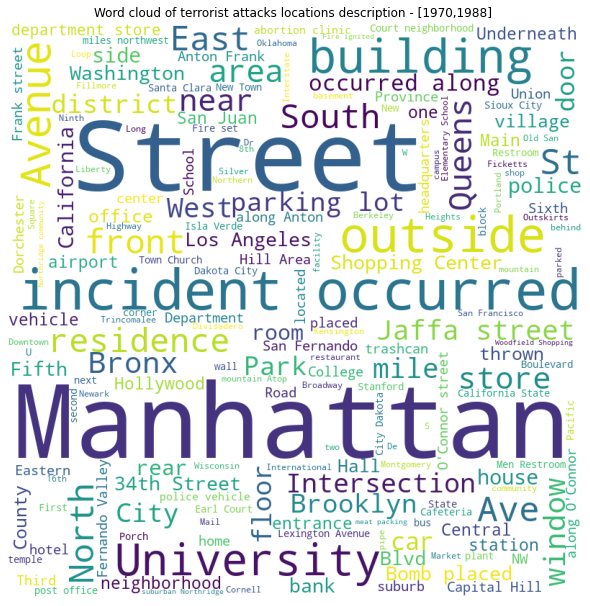

In [19]:
from wordcloud import WordCloud, STOPWORDS 

L = list(dfClass1.location.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks locations description - [1970,1988] ')
plt.show() 

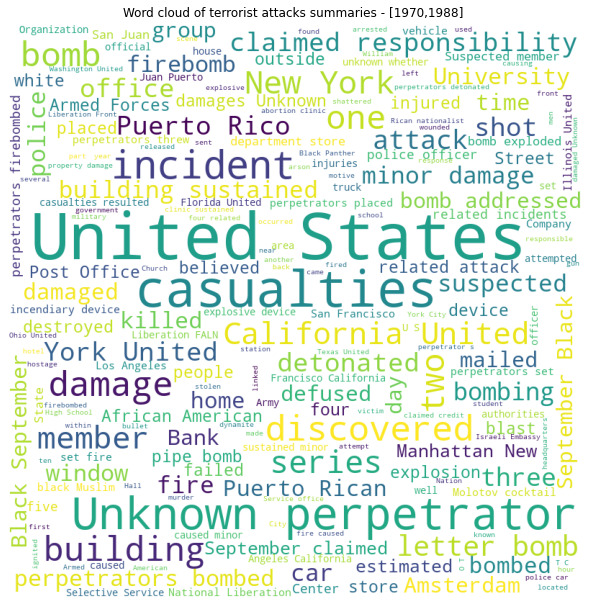

In [20]:
L = list(dfClass1.summary.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks summaries - [1970,1988] ')

plt.show() 

In [21]:
dfClass1Sum = dfClass1.groupby(['country_txt']).sum(['nkill','nwound']).sort_values(by="nkill")
dfClass1Sum = dfClass1Sum.loc[dfClass1Sum["nkill"]+dfClass1Sum["nwound"]!=0] 
#dfClass4Sum[["nkill","nwound"]]

fig = px.bar(dfClass1Sum, x=dfClass1Sum.index.values, y=["nkill", "nwound"],
                 labels={"nkill": "Kills",'nwound':'Wounds'},
                 title='Kills and wounds count per Country between : 1970 & 1988')
fig.show()

In [22]:
dfClass2 = dfClass(2)

#dfClass2
fig = px.sunburst(dfClass2, path=['gname','country_txt'],
                 labels={"count": "Attacks",'id':'path'},
                 title='Group name - Country between : 1989 & 1993')
fig.show()

In [23]:
fig = px.sunburst(dfClass2, path=['targtype1_txt','country_txt'],
                 labels={"count": "Attacks",'id':'path'},
                 title='Target type - Country in between : 1989 & 1993')
fig.show()

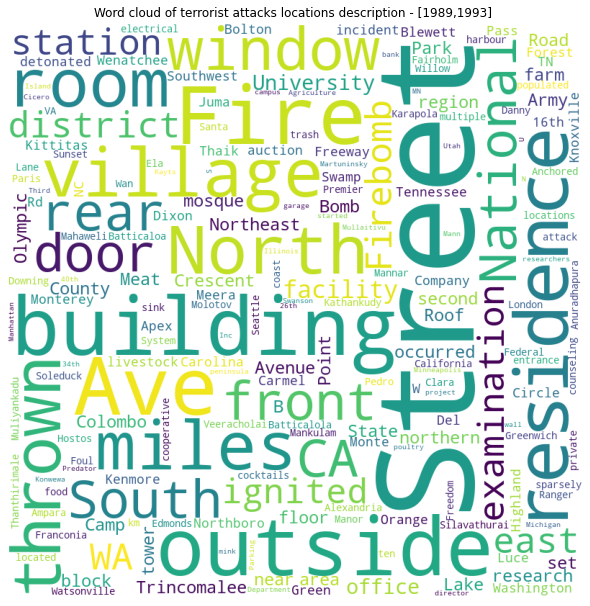

In [24]:
L = list(dfClass2.location.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks locations description - [1989,1993] ')

plt.show() 

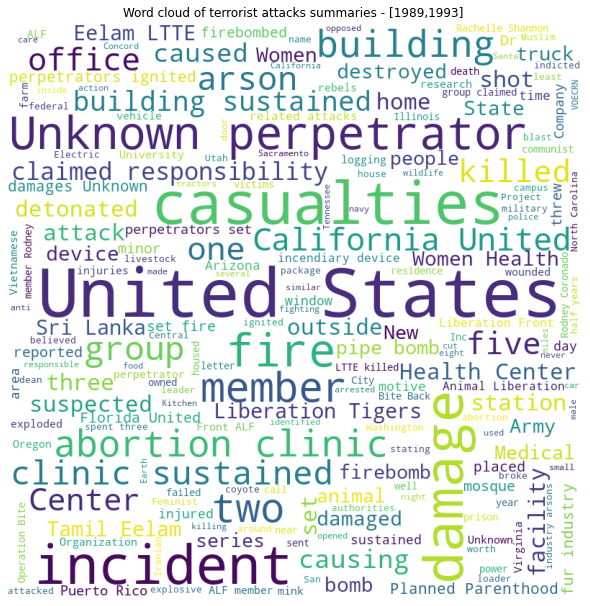

In [25]:
L = list(dfClass2.summary.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks summaries - [1989,1993] ')
plt.show() 

In [26]:
dfClass2Sum = dfClass2.groupby(['country_txt']).sum(['nkill','nwound']).sort_values(by="nkill")
dfClass2Sum = dfClass2Sum.loc[dfClass2Sum["nkill"]+dfClass2Sum["nwound"]!=0] 
#dfClass4Sum[["nkill","nwound"]]

fig = px.bar(dfClass2Sum, x=dfClass2Sum.index.values, y=["nkill", "nwound"],
             labels={"nkill": "Kills",'nwound':'Wounds','x':'Country'},
             title='Kills and wounds count per Country between : 1989 & 1993')
fig.show()

In [27]:
dfClass3 = dfClass(3)

#dfClass3
fig = px.sunburst(dfClass3, path=['gname','country_txt'],
                  labels={"count": "Attacks",'id':'path'},
                 title='Group name - Country between : 1994 & 2007')
fig.show()

In [28]:
fig = px.sunburst(dfClass3, path=['targtype1_txt','country_txt'],
                 labels={"count": "Attacks",'id':'path'},
                 title='Target type - Country in between : 1994 & 2007')
fig.show()

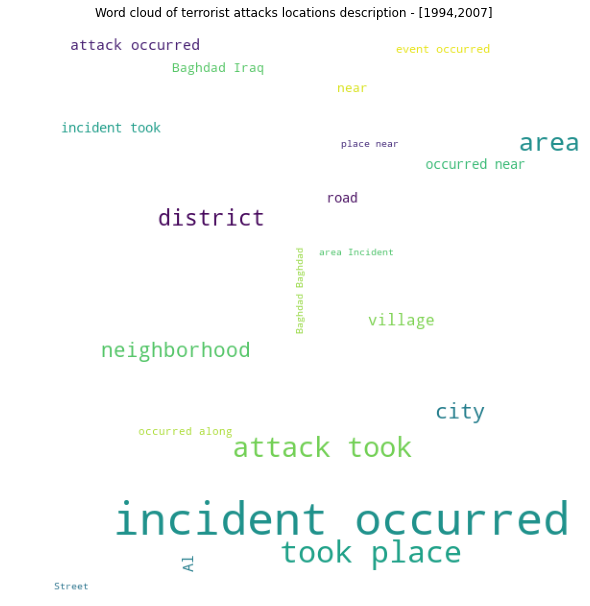

In [29]:
L = list(dfClass3.location.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 600, height = 600, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks locations description - [1994,2007] ')

plt.show() 

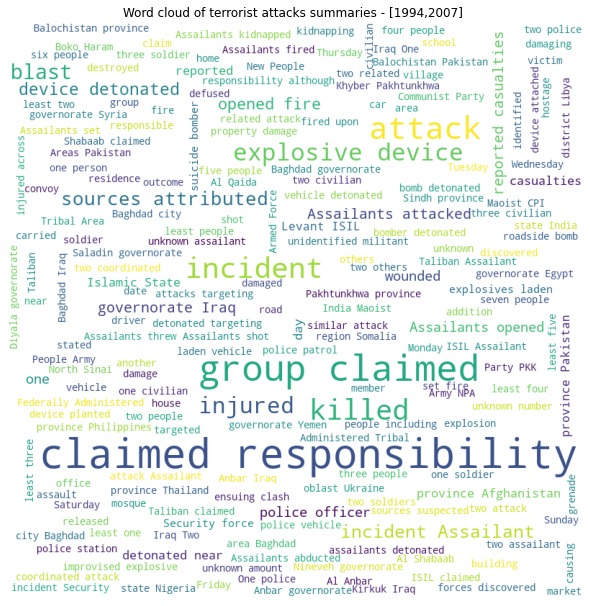

In [30]:
L = list(dfClass3.summary.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks summaries - [1994,2007] ')
plt.show() 

In [31]:
dfClass3Sum = dfClass3.groupby(['country_txt']).sum(['nkill','nwound']).sort_values(by="nkill")
dfClass3Sum = dfClass3Sum.loc[dfClass3Sum["nkill"]+dfClass3Sum["nwound"]!=0] 
#dfClass4Sum[["nkill","nwound"]]

fig = px.bar(dfClass3Sum, x=dfClass3Sum.index.values, y=["nkill", "nwound"],
             labels={"nkill": "Kills",'nwound':'Wounds','x':'Country'},
             title='Kills and wounds count per Country between : 1994 & 2007')
fig.show()

In [32]:
dfClass4 = dfClass(4)

#dfClass4
fig = px.sunburst(dfClass4, path=['gname','country_txt'],
             labels={"nkill": "Kills",'nwound':'Wounds','x':'Country'},
             title='Kills and wounds count per Country between : 2008 & 2017')
fig.show()

In [33]:
fig = px.sunburst(dfClass4, path=['targtype1_txt','country_txt'],
                 labels={"count": "Attacks",'id':'path'},
                 title='Target type - Country in between : 2007 & 2017')
fig.show()

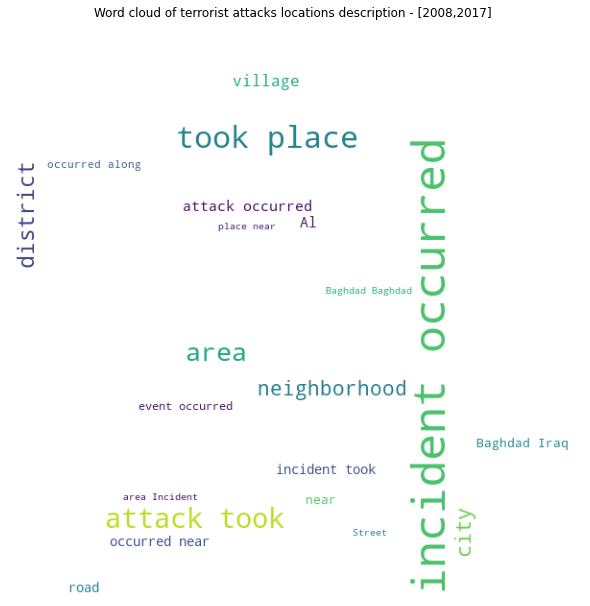

In [34]:
L = list(dfClass4.location.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 600, height = 600, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks locations description - [2008,2017] ')
plt.show() 

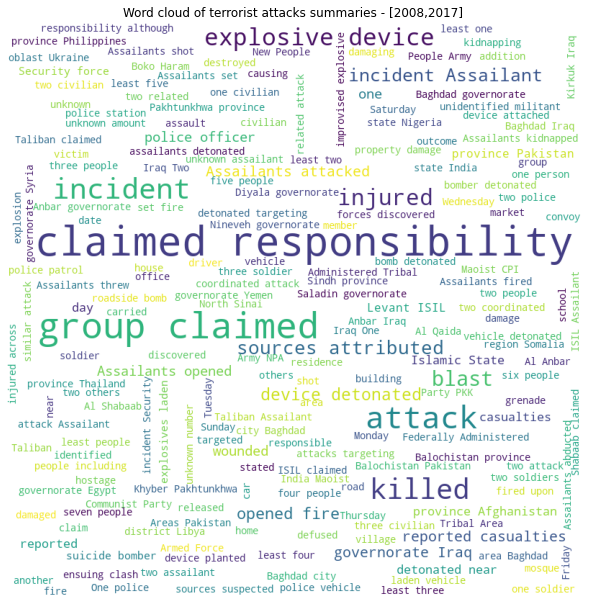

In [35]:
L = list(dfClass4.summary.dropna().values)
L = ' '.join(L)

stopwords = set(STOPWORDS) 
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(L)
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.title('Word cloud of terrorist attacks summaries - [2008,2017] ')
plt.show() 

In [36]:
dfClass4Sum = dfClass4.groupby(['country_txt']).sum(['nkill','nwound']).sort_values(by="nkill")
dfClass4Sum = dfClass4Sum.loc[dfClass4Sum["nkill"]+dfClass4Sum["nwound"]!=0] 
#dfClass4Sum[["nkill","nwound"]]

fig = px.bar(dfClass4Sum, x=dfClass4Sum.index.values, y=["nkill", "nwound"],
             labels={"nkill": "Kills",'nwound':'Wounds','x':'Country'},
             title='Kills and wounds count per Country between : 2008 & 2017')
fig.show()

## Thank You 